# Business Cases - Group Project

### Students:
- M20200581 - Andreia Taboleiros
- R2015528 - Raquel Castro
- M20200620 - Ricardo Santos
- M20190773 - Tiago Faria

# 1. Data Understanding 

The dataset has, in total, 28 numeric variables. The first step of the process will be to ensure that the data is of good quality.

In order to achieve that, our team will focus on:

1. Ensure that there are no duplicates, 
2. Check for missing values, typos and/or non-sensical entries
3. Check how each variable is distributed
4. Detect outliers 


In [1]:
#importing libraries
#Standard data packages

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

#pandas profiling
from pandas_profiling import ProfileReport
#SKlearn preprocessing and model selection tools

from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler, QuantileTransformer

#SKlearn clustering tools
from sklearn.neighbors import LocalOutlierFactor
from sklearn.impute import KNNImputer
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AgglomerativeClustering , KMeans, DBSCAN
from scipy.cluster.hierarchy import dendrogram
from sklearn.metrics import silhouette_score

#other packages
import statistics
from math import ceil
from collections import Counter
from sklearn.metrics import calinski_harabasz_score

import warnings
warnings.filterwarnings('ignore')

### 1.1 Data Importation

In [2]:
#imports dataset
#The initial dataset had, as final row, the total of each column
#It also had a final column called rand which had no meaning and was removed before loading data

#load data and set custid as index
df = pd.read_excel(r'WonderfulWinesoftheWorld.xlsx').set_index('Custid', drop = True)
df.head()

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,...,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
Custid,,,,,,,,,,,,,,,,,,,,,
5325,653,55,20,78473,0,0,20,18,826,445,...,5,0,0,0,0,0,0,0,0,0
3956,1041,75,18,105087,0,0,36,33,1852,539,...,4,0,0,0,1,0,0,0,0,0
3681,666,18,12,27984,1,0,4,56,39,-7,...,8,0,0,0,0,0,0,0,0,0
2829,1049,42,16,61748,1,1,2,46,37,-6,...,7,0,0,0,0,0,0,0,1,1
8788,837,47,16,65789,0,1,2,3,36,4,...,6,0,0,0,0,0,0,0,0,0


### 1.2 Descriptive Analysis 

In [3]:
# Display info
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 5325 to 4914
Data columns (total 28 columns):
 #   Column       Non-Null Count  Dtype
---  ------       --------------  -----
 0   Dayswus      10000 non-null  int64
 1   Age          10000 non-null  int64
 2   Edu          10000 non-null  int64
 3   Income       10000 non-null  int64
 4   Kidhome      10000 non-null  int64
 5   Teenhome     10000 non-null  int64
 6   Freq         10000 non-null  int64
 7   Recency      10000 non-null  int64
 8   Monetary     10000 non-null  int64
 9   LTV          10000 non-null  int64
 10  Perdeal      10000 non-null  int64
 11  Dryred       10000 non-null  int64
 12  Sweetred     10000 non-null  int64
 13  Drywh        10000 non-null  int64
 14  Sweetwh      10000 non-null  int64
 15  Dessert      10000 non-null  int64
 16  Exotic       10000 non-null  int64
 17  WebPurchase  10000 non-null  int64
 18  WebVisit     10000 non-null  int64
 19  SMRack       10000 non-null  int64
 20  LGRa

In [4]:
#obtaining some general descriptive stats of df
df.describe(include = 'all').T

,count,mean,std,min,25%,50%,75%,max
Dayswus,10000.0,898.1020,202.492789,550.0,723.75,894.0,1074.00,1250.0
Age,10000.0,47.9273,17.302721,18.0,33.00,48.0,63.00,78.0
Edu,10000.0,16.7391,1.876375,12.0,15.00,17.0,18.00,20.0
Income,10000.0,69904.3580,27612.233311,10000.0,47642.00,70012.0,92147.00,140628.0
Kidhome,10000.0,0.4188,0.493387,0.0,0.00,0.0,1.00,1.0
Teenhome,10000.0,0.4698,0.499112,0.0,0.00,0.0,1.00,1.0
Freq,10000.0,14.6281,11.969073,1.0,4.00,12.0,24.00,56.0
Recency,10000.0,62.4068,69.874255,0.0,26.00,52.0,78.25,549.0
Monetary,10000.0,622.5552,647.135323,6.0,63.00,383.0,1077.00,3052.0
LTV,10000.0,209.0712,291.986040,-178.0,-2.00,57.0,364.00,1791.0


In [5]:
#Step1 Checking for missing values
df.isnull().sum()

Dayswus        0
Age            0
Edu            0
Income         0
Kidhome        0
Teenhome       0
Freq           0
Recency        0
Monetary       0
LTV            0
Perdeal        0
Dryred         0
Sweetred       0
Drywh          0
Sweetwh        0
Dessert        0
Exotic         0
WebPurchase    0
WebVisit       0
SMRack         0
LGRack         0
Humid          0
Spcork         0
Bucket         0
Access         0
Complain       0
Mailfriend     0
Emailfriend    0
dtype: int64

In [6]:
# Checking for duplicates
df.loc[df.duplicated(keep=False), :]

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,...,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
Custid,,,,,,,,,,,,,,,,,,,,,


array([[<AxesSubplot:title={'center':'Dayswus'}>,
        <AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'Edu'}>,
        <AxesSubplot:title={'center':'Income'}>,
        <AxesSubplot:title={'center':'Kidhome'}>],
       [<AxesSubplot:title={'center':'Teenhome'}>,
        <AxesSubplot:title={'center':'Freq'}>,
        <AxesSubplot:title={'center':'Recency'}>,
        <AxesSubplot:title={'center':'Monetary'}>,
        <AxesSubplot:title={'center':'LTV'}>],
       [<AxesSubplot:title={'center':'Perdeal'}>,
        <AxesSubplot:title={'center':'Dryred'}>,
        <AxesSubplot:title={'center':'Sweetred'}>,
        <AxesSubplot:title={'center':'Drywh'}>,
        <AxesSubplot:title={'center':'Sweetwh'}>],
       [<AxesSubplot:title={'center':'Dessert'}>,
        <AxesSubplot:title={'center':'Exotic'}>,
        <AxesSubplot:title={'center':'WebPurchase'}>,
        <AxesSubplot:title={'center':'WebVisit'}>,
        <AxesSubplot:title={'center':'SMRack'}>],
       [<

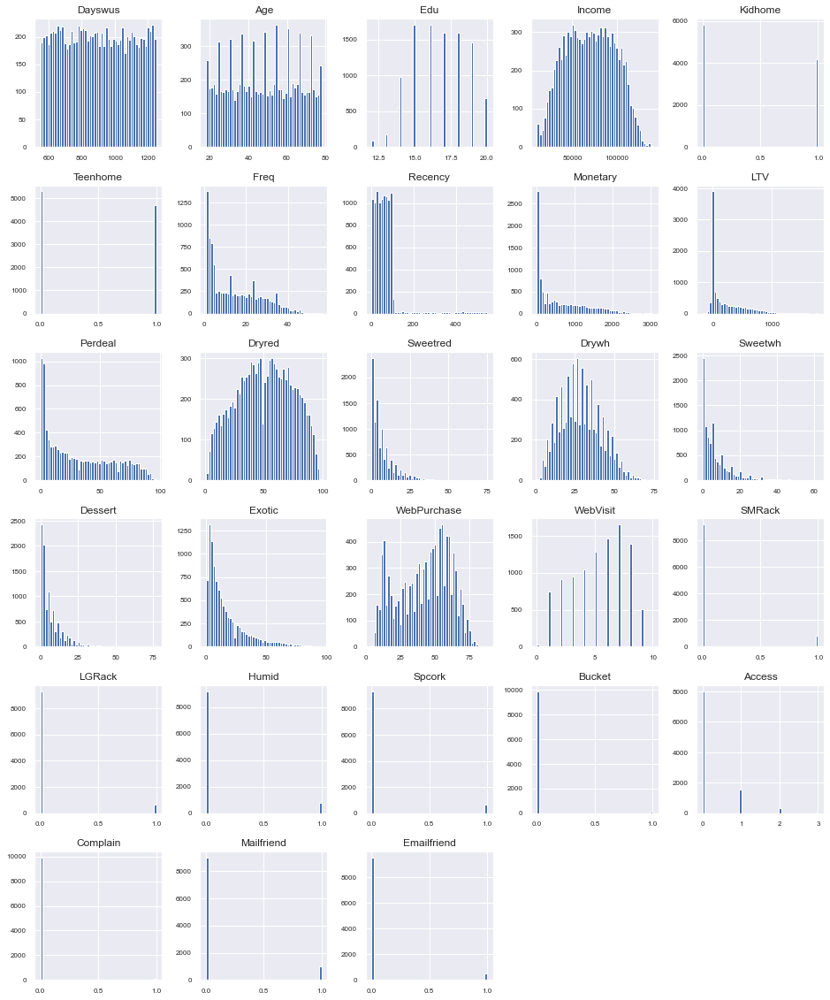

In [7]:
#Plot the distributions of each feature
df.hist(figsize=(16, 20), bins=50, xlabelsize=8, ylabelsize=8)

On a very preliminary glance, it seems that the data doesn't have observable glaring flaws in its integrity. The dataset is complete and lacks duplicated rows. All values in the cells are of the expected type (int) and are whithin the expected range of possible values for each feature. 



## 2. Data Preparation

### 2.1 Outlier Removal

We will look deeper into the values. In particular, given that our goal is to be able to generalize, we will perform outlier detection techniques. Two outlier detection techniques wil be performed:

<b> - LOF

<b>  - DBSCAN
    
Entries that are considered outliers in 2 techniques will be removed. 

In [8]:
# Define metric features
metric_features = df[["Dayswus", "Age",'Edu', "Income", "LTV", \
                                     "Freq",'Recency','Monetary', "Access", "WebVisit", "Perdeal", \
                                    "Dryred", "Sweetred", "Drywh", "Sweetwh", \
                                     "Dessert", "Exotic", "WebPurchase"]]

#Save all percentual features
perc= ['Perdeal',"Dryred", "Sweetred", "Drywh", "Sweetwh", "Dessert", "Exotic","WebPurchase"]

#### 2.1.1 Local Outlier Factor (LOF)

In [9]:
lof = LocalOutlierFactor(n_neighbors=20)
lof_labels = lof.fit_predict(metric_features)
Counter(lof_labels)

#values marked with -1 are outliers

Counter({1: 9847, -1: 153})

In [10]:
lof_outliers = df[lof_labels==-1]
df_outliers = df.loc[lof_outliers.index.to_list(),:]
df_outliers = df_outliers.reset_index()
df_outliers

,Custid,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,...,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
0,6523,736,36,15,40516,1,1,1,440,11,...,6,0,0,0,0,0,0,0,0,0
1,4896,1100,45,18,51806,1,1,1,498,18,...,6,0,0,0,0,0,0,0,0,0
2,8554,1074,77,15,140628,0,0,48,36,2589,...,3,0,0,1,1,0,1,0,0,0
3,3117,960,23,16,51453,1,0,1,465,20,...,8,0,0,0,0,0,0,0,0,0
4,3142,1019,24,16,45638,1,1,1,495,19,...,5,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148,10676,1236,62,17,79885,0,1,31,24,1540,...,8,0,0,0,0,0,0,0,0,0
149,5832,577,18,12,35657,1,0,1,547,10,...,6,0,0,0,0,0,0,0,0,0
150,10532,1108,33,15,45196,1,0,15,92,546,...,9,0,0,0,0,0,0,0,0,0
151,4137,729,33,18,44301,1,1,1,527,14,...,7,0,0,0,0,0,0,0,0,0


#### 2.1.2 DBSCAN

In [11]:
model = DBSCAN(eps = 400, min_samples = 3).fit(metric_features)
db_outliers = metric_features[model.labels_ == -1]
db_outliers.reset_index(inplace = True) 
db_outliers

,Custid,Dayswus,Age,Edu,Income,LTV,Freq,Recency,Monetary,Access,WebVisit,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase
0,8554,1074,77,15,140628,1608,48,36,2589,1,3,0,39,7,40,6,8,8,18
1,4338,1062,78,15,118350,789,47,44,2528,1,2,1,16,7,55,8,15,1,9
2,6787,713,78,14,133815,803,46,24,2470,2,2,1,39,14,32,8,7,1,15
3,10996,967,28,17,54292,436,23,72,1011,0,6,7,41,11,36,1,11,42,31
4,7184,1115,74,17,131771,1549,50,61,2703,3,3,1,59,4,18,7,12,13,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,5834,1171,77,16,104030,1325,47,80,2526,1,4,1,44,3,44,3,6,2,11
117,2384,1007,60,18,73461,556,31,12,1531,1,3,2,61,2,30,5,1,3,20
118,6870,1023,71,16,124214,866,48,94,2585,1,2,0,58,0,28,8,6,4,10
119,6580,1082,74,16,116419,787,49,86,2648,2,2,1,77,1,20,2,0,2,7


In [12]:
#merge both outliers dataframes to get all the instances repeated in both
outliers = pd.merge(df_outliers, db_outliers, how = 'inner', on = 'Custid').set_index('Custid', drop = True)
outliers

,Dayswus_x,Age_x,Edu_x,Income_x,Kidhome,Teenhome,Freq_x,Recency_x,Monetary_x,LTV_x,...,Access_y,WebVisit_y,Perdeal_y,Dryred_y,Sweetred_y,Drywh_y,Sweetwh_y,Dessert_y,Exotic_y,WebPurchase_y
Custid,,,,,,,,,,,,,,,,,,,,,
8554,1074,77,15,140628,0,0,48,36,2589,1608,...,1,3,0,39,7,40,6,8,8,18
10996,967,28,17,54292,0,0,23,72,1011,436,...,0,6,7,41,11,36,1,11,42,31
6504,1219,61,18,78637,0,0,40,81,2109,1103,...,0,7,2,48,6,38,5,3,3,33
7255,1228,51,20,66222,0,0,28,35,1343,421,...,1,8,7,88,2,9,1,1,29,54
1528,1192,57,17,76993,0,1,32,27,1595,361,...,0,7,13,61,8,16,6,9,8,40
10005,710,45,16,57868,0,0,20,15,831,257,...,0,6,8,36,2,32,29,1,3,39
5893,866,32,16,53971,1,0,1,495,16,0,...,0,4,48,33,5,51,10,1,4,46
1634,1217,66,17,84670,0,0,31,40,1541,791,...,0,8,7,65,1,22,6,6,7,50
5106,1121,75,19,85848,0,0,41,50,2166,955,...,0,3,2,53,7,35,2,3,8,12


The outlier removel techniques encountered 26 outliers.

In [13]:
#removal of outliers from the working dataframe
key = list(outliers.index.values)
key
metric_features = metric_features.drop(index = key)

## 2.2 Normalization

Considering the characteristics of the data presented,
the normalization techniques will be performed on all metric features, except the one representing
percentages.
MinMax Scaler will be used to transform data into a scale between 0 and 1, like the percentage features.
<br> In modeling phase a GMM algorithm will be used, in that testing scenario the scaler to be used is Quantile Transformer because data needs to have the best aproximation to a normal distribution.

In [14]:
#scaler = QuantileTransformer(output_distribution='normal') -> Use when testing GMM
scaler = MinMaxScaler()
metric_features[metric_features.drop(columns=perc).columns] = scaler.fit_transform(metric_features.drop(columns=perc))
metric_features[perc] = metric_features[perc]/100
metric_features

,Dayswus,Age,Edu,Income,LTV,Freq,Recency,Monetary,Access,WebVisit,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase
Custid,,,,,,,,,,,,,,,,,,
5325,0.147143,0.616667,1.000,0.537726,0.316404,0.345455,0.032787,0.269206,0.000000,0.5,0.07,0.67,0.04,0.26,0.02,0.01,0.01,0.36
3956,0.701429,0.950000,0.750,0.746729,0.364144,0.636364,0.060109,0.606041,0.000000,0.4,0.02,0.49,0.00,0.46,0.01,0.03,0.00,0.20
3681,0.165714,0.000000,0.000,0.141230,0.086846,0.054545,0.102004,0.010834,0.000000,0.8,0.88,0.04,0.29,0.14,0.32,0.21,0.48,0.60
2829,0.712857,0.400000,0.500,0.406383,0.087354,0.018182,0.083789,0.010177,0.000000,0.7,0.70,0.86,0.01,0.11,0.01,0.01,0.55,0.59
8788,0.410000,0.483333,0.500,0.438117,0.092433,0.018182,0.005464,0.009849,0.000000,0.6,0.35,0.85,0.00,0.12,0.02,0.01,0.28,0.63
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383,0.831429,0.650000,1.000,0.557830,0.185373,0.327273,0.107468,0.252791,0.333333,0.4,0.22,0.78,0.00,0.20,0.01,0.01,0.11,0.27
4070,0.065714,0.800000,0.375,0.586738,0.288979,0.309091,0.081967,0.234406,0.000000,0.2,0.05,0.30,0.12,0.36,0.10,0.12,0.13,0.18
7909,0.098571,0.000000,0.000,0.239253,0.092941,0.036364,0.118397,0.013460,0.000000,0.5,0.23,0.06,0.24,0.10,0.38,0.22,0.41,0.58


### 2.3 Division of data into categories

In order to have more meaningful insights, the features will be divided into categories according to their characteristics.   

In [15]:
#3 perspectives: 
#Customer preferences, types of products they buy
Consumption_preferences = ["Dryred", "Sweetred", "Drywh", "Sweetwh","Dessert", "Exotic",\
                            "SMRack","LGRack", "Humid","Spcork", "Bucket"]       

#socio-economical analysis
Socioeconomics = ["Edu","Income","Kidhome","Teenhome"]

#interaction and behaviour with store 
Store_Interactions = ["WebPurchase", "Perdeal","Recency","Monetary","Freq", "Dayswus", \
                                      "Access", "WebVisit", "Complain","Mailfriend","Emailfriend",'LTV']                     

In [16]:
complete_df= df.copy()
complete_df[metric_features.columns]= metric_features
complete_df = complete_df.drop(index = key)
complete_df

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,...,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
Custid,,,,,,,,,,,,,,,,,,,,,
5325,0.147143,0.616667,1.000,0.537726,0,0,0.345455,0.032787,0.269206,0.316404,...,0.5,0,0,0,0,0,0.000000,0,0,0
3956,0.701429,0.950000,0.750,0.746729,0,0,0.636364,0.060109,0.606041,0.364144,...,0.4,0,0,0,1,0,0.000000,0,0,0
3681,0.165714,0.000000,0.000,0.141230,1,0,0.054545,0.102004,0.010834,0.086846,...,0.8,0,0,0,0,0,0.000000,0,0,0
2829,0.712857,0.400000,0.500,0.406383,1,1,0.018182,0.083789,0.010177,0.087354,...,0.7,0,0,0,0,0,0.000000,0,1,1
8788,0.410000,0.483333,0.500,0.438117,0,1,0.018182,0.005464,0.009849,0.092433,...,0.6,0,0,0,0,0,0.000000,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383,0.831429,0.650000,1.000,0.557830,0,1,0.327273,0.107468,0.252791,0.185373,...,0.4,1,0,0,0,0,0.333333,0,1,0
4070,0.065714,0.800000,0.375,0.586738,0,0,0.309091,0.081967,0.234406,0.288979,...,0.2,0,0,0,0,0,0.000000,0,0,0
7909,0.098571,0.000000,0.000,0.239253,0,0,0.036364,0.118397,0.013460,0.092941,...,0.5,0,0,0,0,0,0.000000,0,0,0


## 2.4 Correlations

### 2.4.1 Global PairGrid

In [17]:
#hidden ofor faster computation

#perform a very simple pairplot
g = sns.PairGrid(complete_df, height = 10, corner = True)

#frequency histogram on diagonal
g.map_diag(sns.histplot, color = 'grey', stat = 'frequency', kde = True)

#regplot is a scatter with regression line
g.map_offdiag(sns.regplot, fit_reg=True, x_jitter=.1, color = 'salmon',  marker = 'x')

plt.suptitle("Relationship Between Variables")

Text(0.5, 0.98, 'Relationship Between Variables')

On diagonal row will see the variable distribution , on non-diagonal rows we have the relationship between the different variables


### 2.4.2 Global Phik Correlation

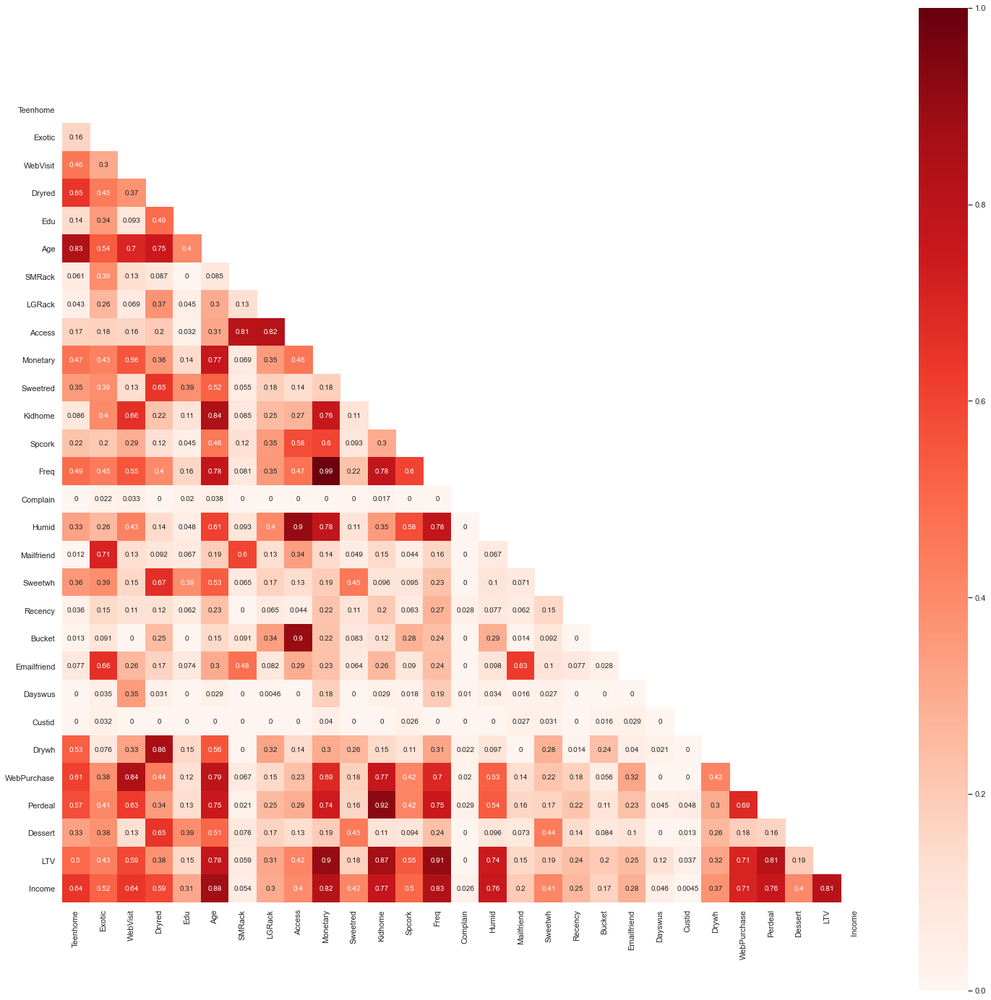

In [18]:
prof = ProfileReport(df=complete_df,explorative=True)
correlations = prof.description_set["correlations"]
corr= correlations["phi_k"]

mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(25,25))
    ax = sns.heatmap(corr, mask=mask, annot = True,cmap='Reds',square=True,vmin=0, vmax=1)

### 2.4.3 Category Correlations of Consuption Preferences

#### 2.4.3.1 Spearman Correlation

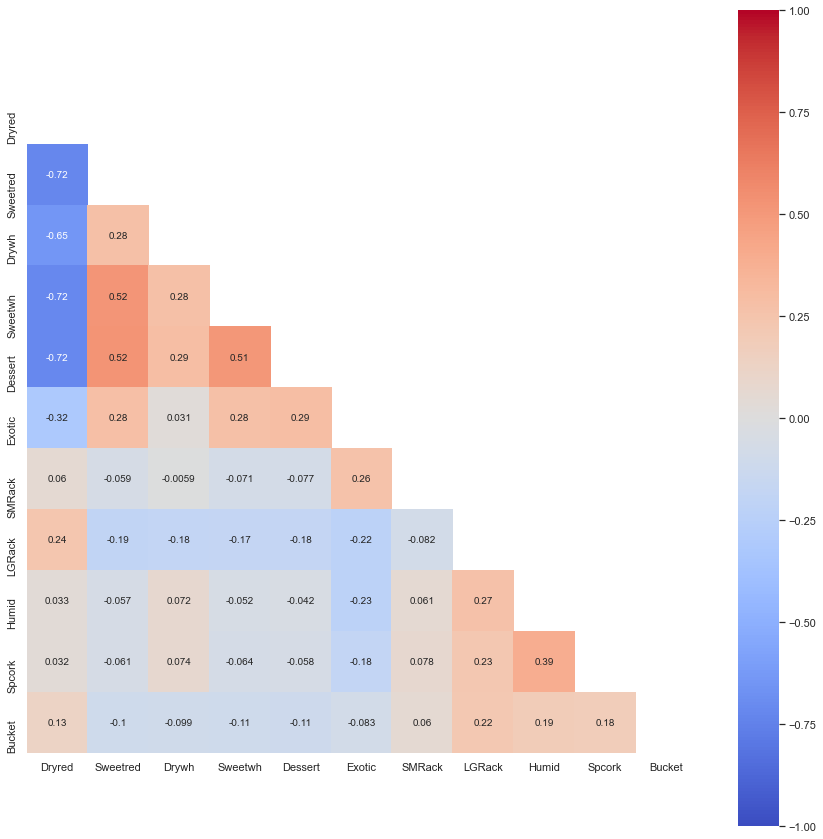

In [19]:
mask = np.zeros_like(complete_df[Consumption_preferences].corr("spearman"))
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(15,15))
    ax = sns.heatmap(complete_df[Consumption_preferences].corr("spearman"),mask=mask, annot = True,cmap='coolwarm',square=True,vmin=-1, vmax=1)

It was decided to keep the following features: Sweetred, Drywh, Sweetwh, Dessert and Exotic.

In [17]:
#Variables to keep
Final_Consumption_preferences =  ['Dryred',"Sweetred", "Drywh", "Sweetwh","Dessert", "Exotic",] 

#### 2.4.3.2 PairGrid

Text(0.5, 0.98, 'Relationship Between Variables')

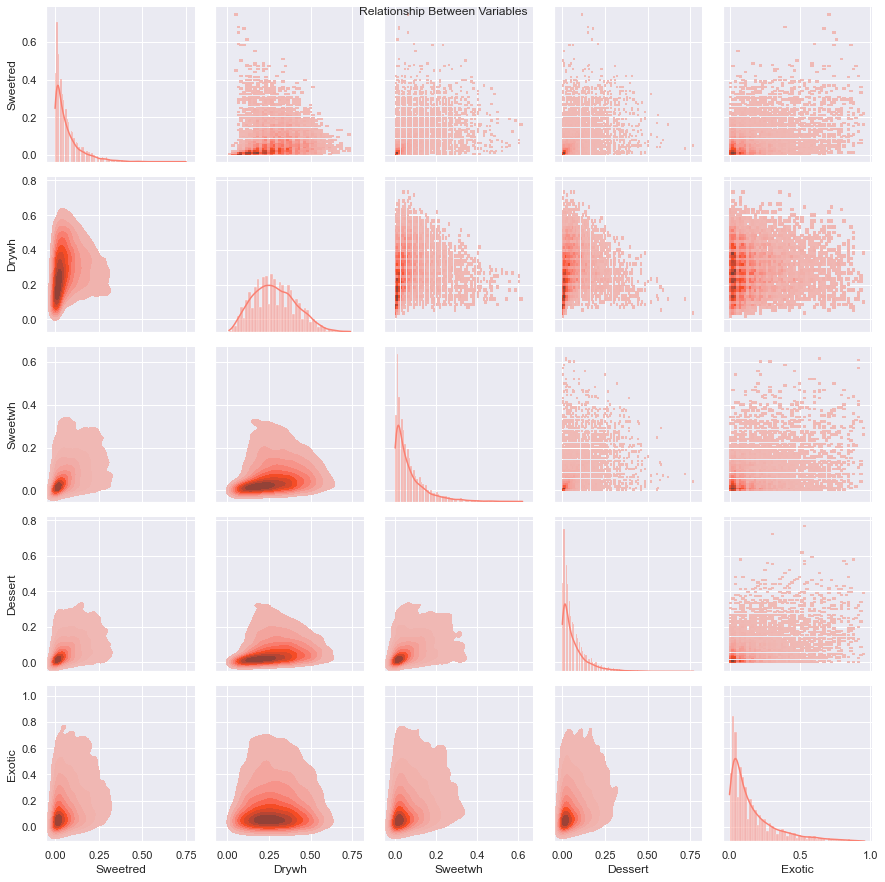

In [22]:
g = sns.PairGrid(complete_df[Final_Consumption_preferences])
g.map_upper(sns.histplot, color = 'salmon')
g.map_lower(sns.kdeplot, fill=True, color = 'salmon')
g.map_diag(sns.histplot, kde=True, color = 'salmon')
plt.suptitle("Relationship Between Variables")

### 2.4.4 Category Correlation of Socioeconomic features

#### 2.4.4.1 Spearman Correlation

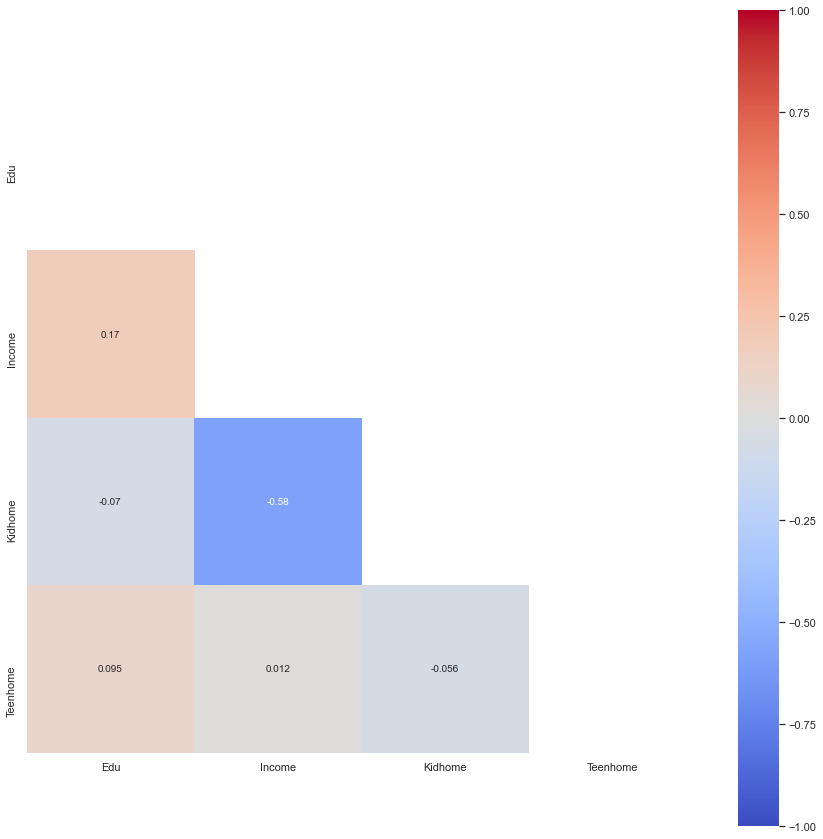

In [23]:
#Correlations in terms of socio-economical variables
mask = np.zeros_like(complete_df[Socioeconomics].corr("spearman"))
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(15,15))
    ax = sns.heatmap(complete_df[Socioeconomics].corr("spearman"),mask=mask, annot = True,cmap='coolwarm',square=True,vmin=-1, vmax=1)

Because Kidhome and Teenhome are binary features the only ones to keep are Edu and Income.

In [18]:
socio_economics_final = ["Edu","Income"]

#### 2.4.4.2 PairGrid

Text(0.5, 0.98, 'Relationship Between Variables')

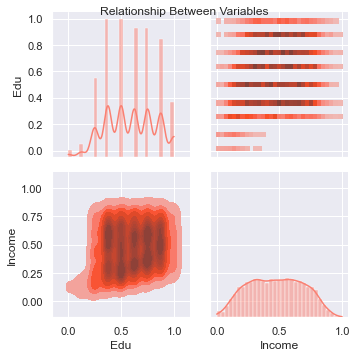

In [25]:
g = sns.PairGrid(complete_df[socio_economics_final])
g.map_upper(sns.histplot, color = 'salmon')
g.map_lower(sns.kdeplot, fill=True, color = 'salmon')
g.map_diag(sns.histplot, kde=True, color = 'salmon')

plt.suptitle("Relationship Between Variables")

### 2.4.5 Category Correlation of Store Interactions

#### 2.4.5.1 Spearman Correlation

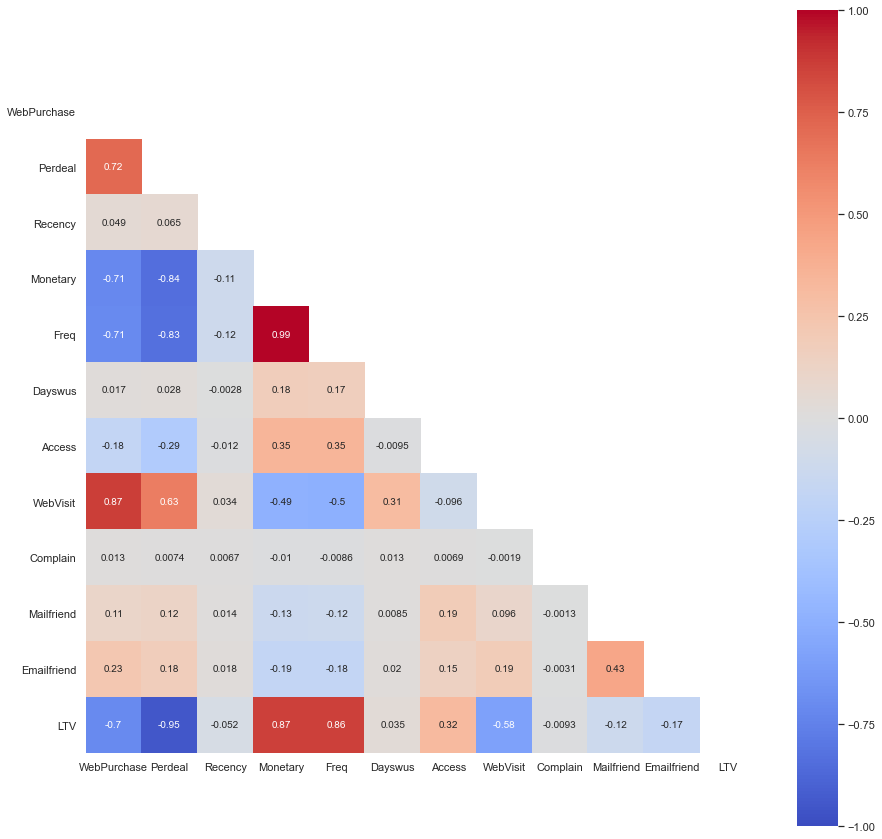

In [26]:
#Correlations in store interactions
mask = np.zeros_like(complete_df[Store_Interactions].corr("spearman"))
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(15,15))
    ax = sns.heatmap(complete_df[Store_Interactions].corr("spearman"),mask=mask, annot = True,cmap='coolwarm',square=True,vmin=-1, vmax=1)

It was decided to keep the following features: Recency, Monetary, Dayswus, Access and WebVisit.

In [19]:
interaction_keep = ["Recency","Monetary", "Dayswus", "Access", "WebVisit"]

#### 2.4.5.2 PairGrid

Text(0.5, 0.98, 'Relationship Between Variables')

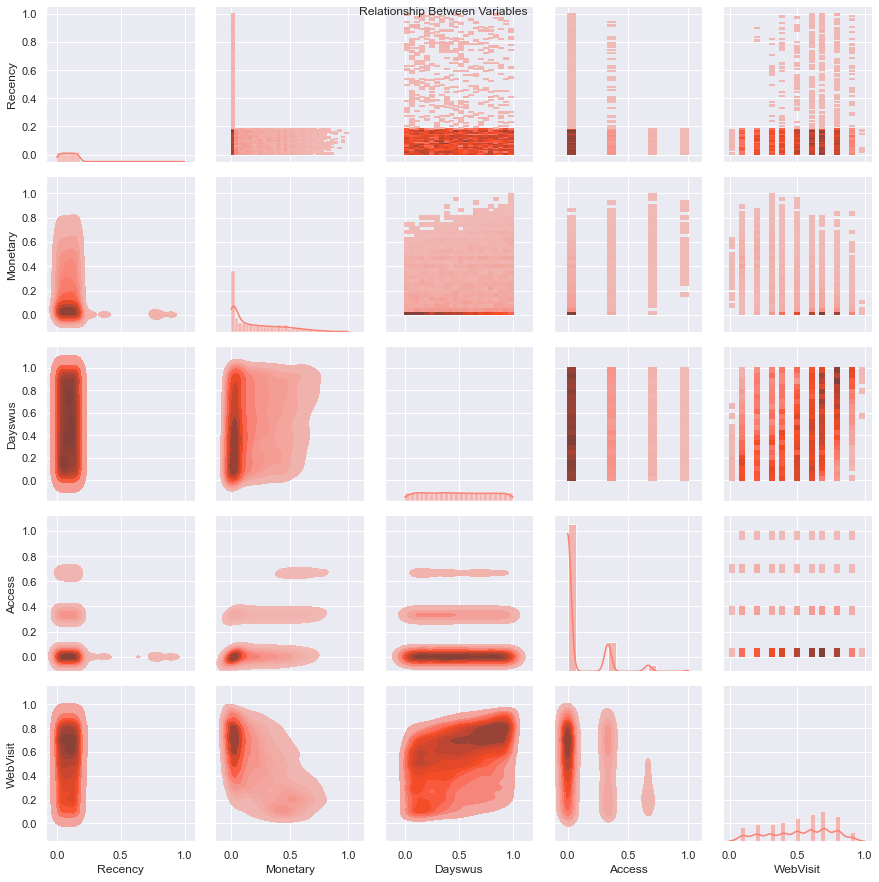

In [28]:
g = sns.PairGrid(complete_df[interaction_keep])
g.map_upper(sns.histplot, color = 'salmon')
g.map_lower(sns.kdeplot, fill=True, color = 'salmon')
g.map_diag(sns.histplot, kde=True, color = 'salmon')

plt.suptitle("Relationship Between Variables")

# 3. Secunndary Feature Selection

In this step a K-means and ocasionaly a Random Forest will be used
in each category to understand which variables are responsable 
for the highest variance in the cluster, and therefore which variables are the most relevant.

## 3.1 Elbow Plots

The elbow plots will be used to understand what is the optimal K for the K-means algorithms. 

In [29]:
def elbow(df):
    inertia = []
    range_clusters = range(1,10)
    for n_clus in range_clusters:
        kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
        kmclust.fit(df)
        inertia.append(kmclust.inertia_) 
        
    plt.figure(figsize=(9,5))
    plt.plot(inertia)
    plt.ylabel("Inertia: SSw")
    plt.xlabel("Number of clusters")
    plt.title("Inertia plot over clusters", size=15)
    plt.show()

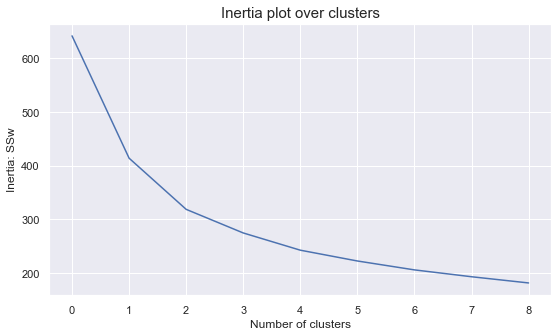

In [30]:
elbow(complete_df[Final_Consumption_preferences])

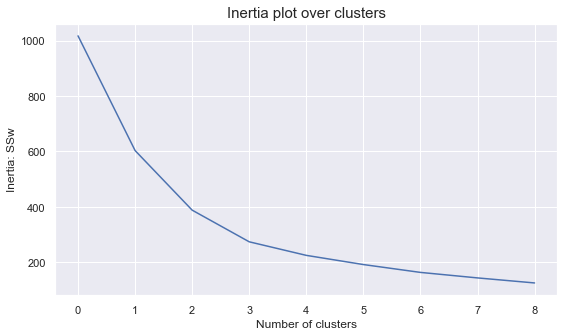

In [31]:
elbow(complete_df[socio_economics_final])

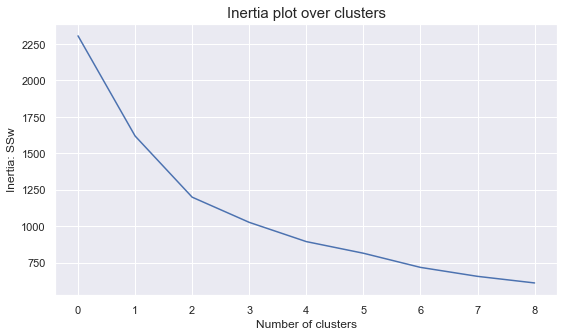

In [32]:
elbow(complete_df[interaction_keep])

In [20]:
#K-means Clustering 
def clus_Kmeans(df, nclust):
    model = KMeans(nclust, random_state=0)
    model.fit(df)
    clust_labels = model.predict(df)
    cent = model.cluster_centers_
    return (clust_labels, cent)

def cluster_profiles(df, label_columns, figsize, compar_titles=None):
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=label, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(s=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
        

    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profilling", fontsize=23)
    plt.show() 
    
def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst

def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars

## 3.2 Consumption Preferences Feature Selection

### 3.2.1 K-means

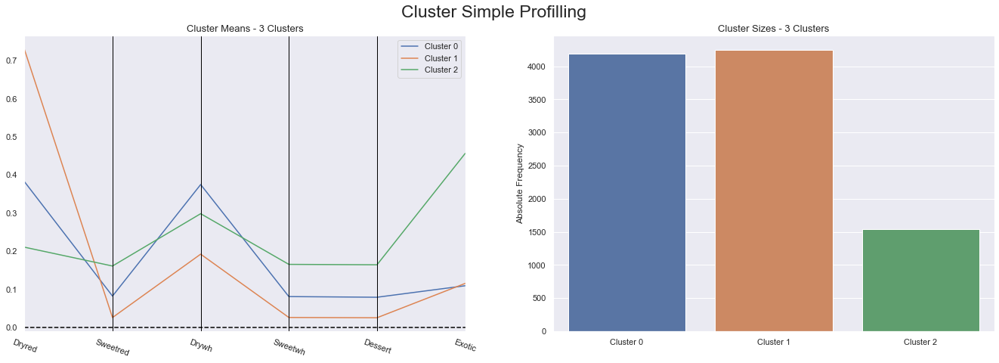

In [24]:
clust_labels, cent = clus_Kmeans(complete_df[Final_Consumption_preferences], 3)
kmeans_df = complete_df[Final_Consumption_preferences].copy()
kmeans_df["k_labels"] = clust_labels
cluster_profiles(kmeans_df, ["k_labels"], figsize=(23, 7))

In [25]:
r2_variables(kmeans_df, ['k_labels']).drop('k_labels').sort_values()

Sweetred    0.350115
Sweetwh     0.352918
Dessert     0.362205
Drywh       0.446262
Exotic      0.518967
Dryred      0.746801
dtype: float64

In [26]:
r2(kmeans_df, ["k_labels"])

0.9211025454458183

### 3.2.2 GMM

In [27]:
#the gmm method was aggregated on a function
from sklearn.mixture import GaussianMixture
def doGMM(df, nclust):
    model=GaussianMixture(n_components=nclust, init_params='kmeans', random_state=0)
    model.fit(df)
    clust_labels = model.predict(df)
    return(clust_labels)

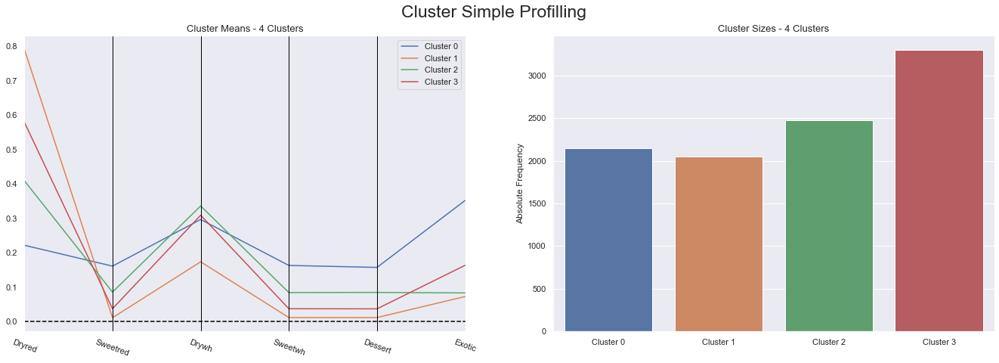

In [28]:
# Comparing both K-means and GMM solutions
clust_labels = doGMM(complete_df[Final_Consumption_preferences], 4)
gmm_df = complete_df[Final_Consumption_preferences].copy()
gmm_df["gmm_labels"] = clust_labels
cluster_profiles(gmm_df, ["gmm_labels"], figsize=(23, 7))

In [29]:
r2_variables(gmm_df, ['gmm_labels']).drop('gmm_labels').sort_values()

Drywh       0.215325
Exotic      0.368620
Dessert     0.443902
Sweetwh     0.462597
Sweetred    0.471528
Dryred      0.695149
dtype: float64

In [30]:
r2(gmm_df, ["gmm_labels"])

0.959178633370959

### 3.2.3 Random Forest

In [31]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestRegressor
def corr_rf(df):
    feature_table = pd.DataFrame(index=df.columns)
    i=0
    for col in df:
        embeded_rf_selector = SelectFromModel(RandomForestRegressor(n_estimators=100), max_features=len(df.columns)-1)
        embeded_rf_selector.fit(df.drop(col,axis=1), df[col])
        embeded_rf_support = embeded_rf_selector.get_support()
        embeded_rf_support = list(embeded_rf_support)
        embeded_rf_support.insert(i,True)
        i+=1

        feature_table[col]=embeded_rf_support
    feature_table['Total'] = np.sum(feature_table, axis=1)
    feature_table = feature_table.sort_values(['Total'] , ascending=False)
    return feature_table

corr_rf(complete_df[Final_Consumption_preferences])

,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,Total
Dryred,True,True,True,True,True,True,6
Drywh,True,True,True,True,True,False,5
Sweetwh,True,False,False,True,False,False,2
Dessert,True,False,False,False,True,False,2
Sweetred,False,True,False,False,False,False,1
Exotic,False,False,False,False,False,True,1


## 3.3 Socioeconomical features Feature Selection

### 3.3.1 K-means

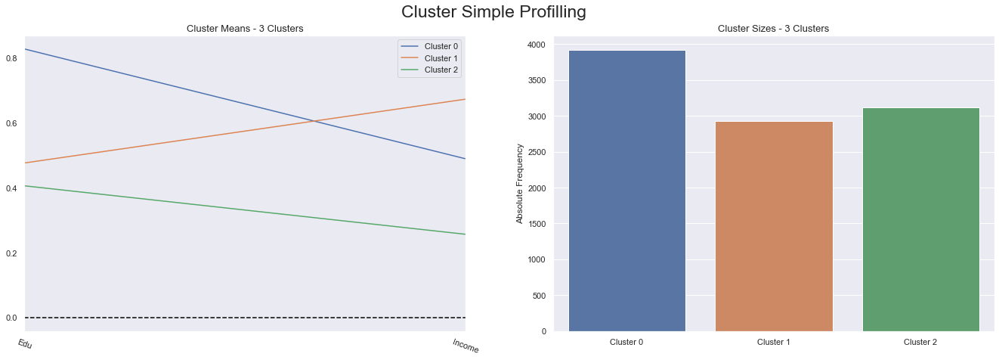

In [42]:
clust_labels, cent = clus_Kmeans(complete_df[socio_economics_final], 3)
kmeans_df = complete_df[socio_economics_final].copy()
kmeans_df["k_labels"] = clust_labels
cluster_profiles(kmeans_df, ["k_labels"], figsize=(23, 7))

In [43]:
r2_variables(kmeans_df, ['k_labels']).drop('k_labels').sort_values()

Income    0.563160
Edu       0.665736
dtype: float64

In [44]:
r2(kmeans_df, ["k_labels"])

0.9514736443702316

### 3.3.2 GMM

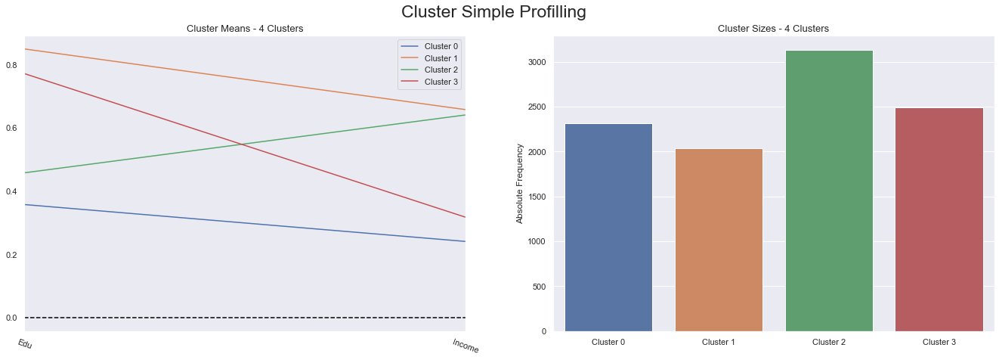

In [45]:
# Comparing both K-means and GMM solutions
clust_labels = doGMM(complete_df[socio_economics_final], 4)
gmm_df = complete_df[socio_economics_final].copy()
gmm_df["gmm_labels"] = clust_labels
cluster_profiles(gmm_df, ["gmm_labels"], figsize=(23, 7))

In [46]:
r2_variables(gmm_df, ['gmm_labels']).drop('gmm_labels').sort_values()

Edu       0.726501
Income    0.729447
dtype: float64

In [47]:
r2(gmm_df, ["gmm_labels"])

0.97878698755252

### 3.3.3 Random Forest

In [48]:
corr_rf(complete_df[socio_economics_final])

,Edu,Income,Total
Edu,True,True,2
Income,True,True,2


## 3.4 Store Interactions Feature Selection


### 3.4.1 K-means

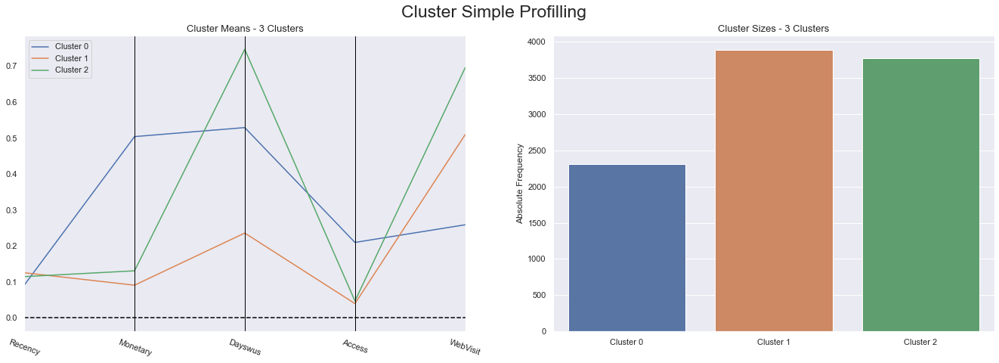

In [49]:
clust_labels, cent = clus_Kmeans(complete_df[interaction_keep], 3)
kmeans_df = complete_df[interaction_keep].copy()
kmeans_df["k_labels"] = clust_labels
cluster_profiles(kmeans_df, ["k_labels"], figsize=(23, 7))

In [50]:
r2_variables(kmeans_df, ['k_labels']).drop('k_labels').sort_values()

Recency     0.010607
Access      0.153483
WebVisit    0.505999
Dayswus     0.602647
Monetary    0.620798
dtype: float64

In [51]:
r2(kmeans_df, ["k_labels"])

0.8533430669451897

### 3.4.2 GMM

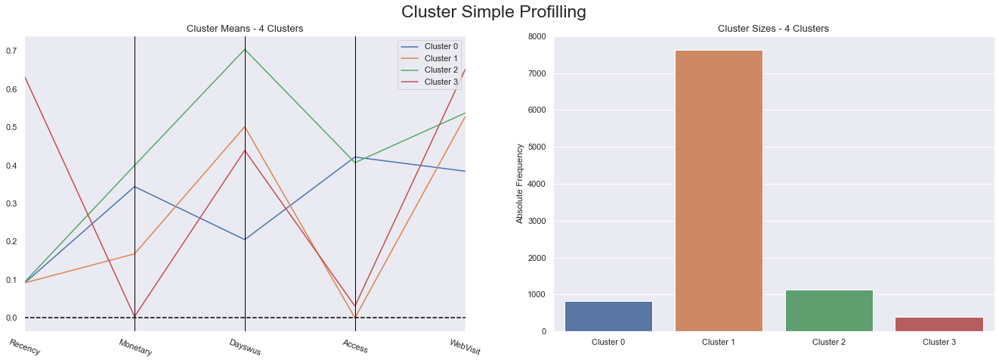

In [52]:
# Comparing both K-means and GMM solutions
clust_labels = doGMM(complete_df[interaction_keep], 4)
gmm_df = complete_df[interaction_keep].copy()
gmm_df["gmm_labels"] = clust_labels
cluster_profiles(gmm_df, ["gmm_labels"], figsize=(23, 7))

In [53]:
r2_variables(gmm_df, ['gmm_labels']).drop('gmm_labels').sort_values()

WebVisit    0.041872
Dayswus     0.143546
Monetary    0.190229
Recency     0.709364
Access      0.826852
dtype: float64

In [54]:
r2(gmm_df, ["gmm_labels"])

0.7038278126151212

### 3.4.3 Random Forest

In [55]:
corr_rf(complete_df[interaction_keep])

,Recency,Monetary,Dayswus,Access,WebVisit,Total
Monetary,True,True,True,True,True,5
Dayswus,True,True,True,True,True,5
Recency,True,False,True,False,False,2
WebVisit,False,True,False,False,True,2
Access,False,False,False,True,False,1


After performing all the analysis it was decided to remove the following variables: Access, Sweetwh and Recency.

In [21]:
#join all categories and drop selectecd features
final_df = complete_df[Final_Consumption_preferences]
final_df.reset_index(inplace=True)
final_df = final_df.merge(complete_df[socio_economics_final], on='Custid') 
final_df = final_df.merge(complete_df[interaction_keep], on='Custid') 
final_df.set_index('Custid',inplace=True)
final_df.drop(columns= ['Access','Sweetwh','Recency'],inplace=True)

# 4. Modeling

Because k-means was the algorithm that provided the best r2 score, it will be the one to perform the clustering.
<br>
<br>
Note- The testing of the GMM algorithm can be viewd at the end of the notebook

### 4.1 Elbow Plot

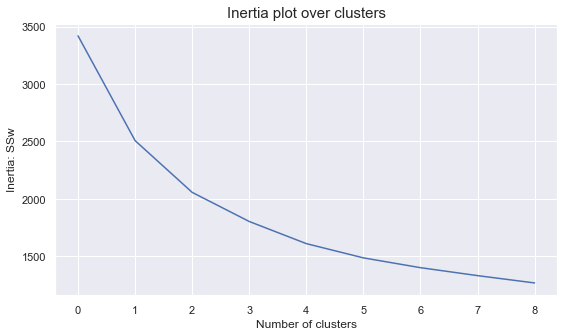

In [57]:
elbow(final_df)

### 4.2 Dendogram

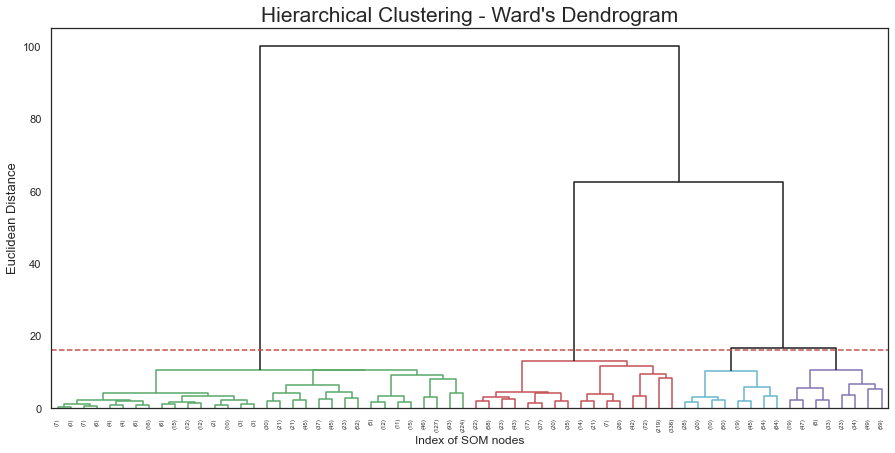

In [58]:
linkage = 'ward'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust_labels = hclust.fit_predict(kmeans_df)
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
# track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
        # If this is True, then we are merging an observation
            current_count += 1 # leaf node
        else:
        # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
            counts[i] = current_count# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
    # the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
[hclust.children_, hclust.distances_, counts]
).astype(float)# Plot the corresponding dendrogram
sns.set()
sns.set_style(style="white")
fig = plt.figure(figsize=(15,7))
# The Dendrogram parameters need to be tuned
y_threshold = 16
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Index of SOM nodes')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()


After analyzing the elbow plot and the dendogram, we can be confident that the optimal K is 4.

### 4.3 Cluster Profiling

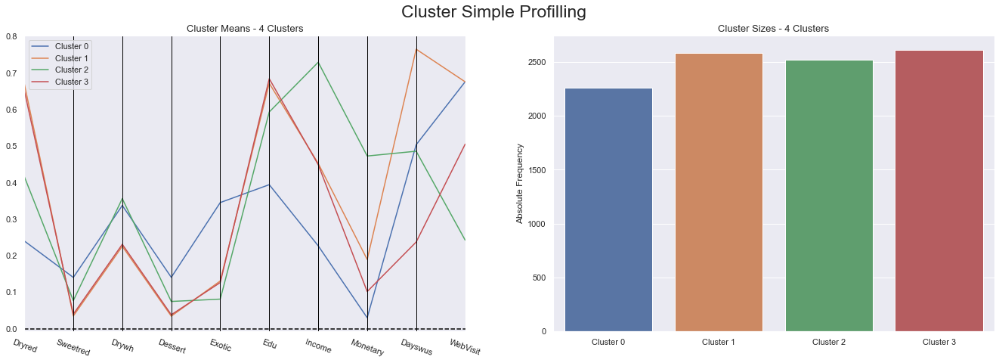

In [34]:
clust_labels, cent = clus_Kmeans(final_df, 4)
kmeans_df = final_df.copy()
kmeans_df["k_labels"] = clust_labels
cluster_profiles(kmeans_df, ["k_labels"], figsize=(23, 7))

In [35]:
r2_variables(kmeans_df, ['k_labels']).drop('k_labels').sort_values()

Drywh       0.226136
Edu         0.231798
Sweetred    0.273785
Dessert     0.278407
Exotic      0.331504
Dayswus     0.434610
Dryred      0.556370
WebVisit    0.576303
Monetary    0.621403
Income      0.651389
dtype: float64

In [36]:
r2(kmeans_df, ["k_labels"])


0.8696598726593936

# 5. Cluster Data Exploration

### 5.1 Box-plots of cluster features

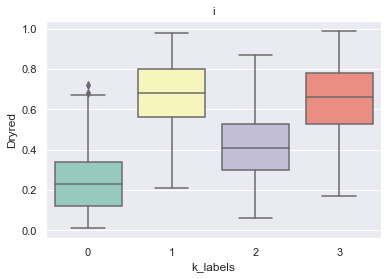

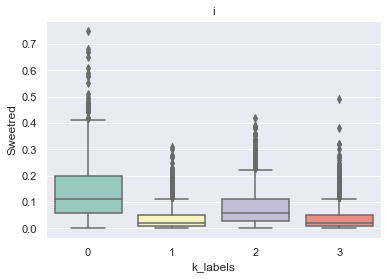

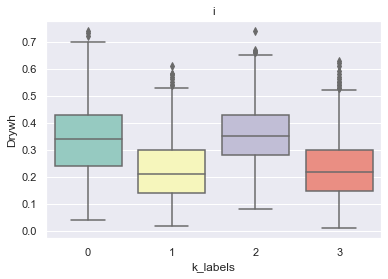

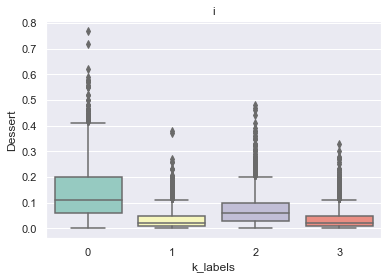

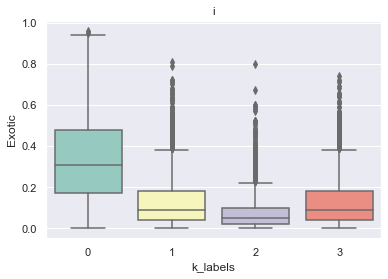

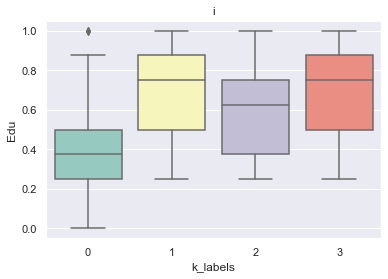

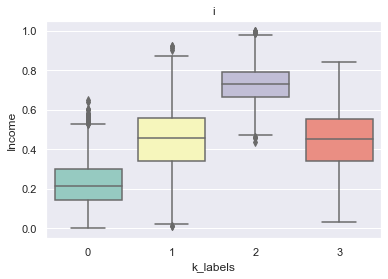

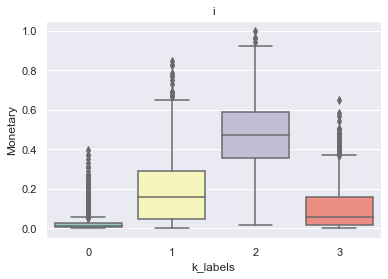

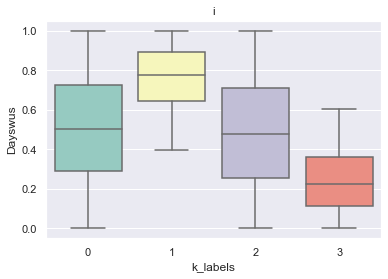

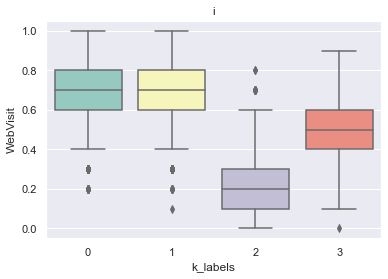

In [37]:
df_plots= kmeans_df.iloc[:,:-1]
fig, axes = figsize=(20, 11)

for i in(df_plots.columns):
    sns.boxplot(x = "k_labels", y = i, data=kmeans_df, palette="Set3")
    plt.title('i')
    plt.show()

In [38]:
#Adding the binary features to back to the data frame
final_dataset = kmeans_df.reset_index()
final_dataset = final_dataset.merge(complete_df[['SMRack','LGRack','Humid','Spcork','Bucket','Complain','Mailfriend','Emailfriend','Teenhome','Kidhome']], on='Custid') 
final_dataset

,Custid,Dryred,Sweetred,Drywh,Dessert,Exotic,Edu,Income,Monetary,Dayswus,...,SMRack,LGRack,Humid,Spcork,Bucket,Complain,Mailfriend,Emailfriend,Teenhome,Kidhome
0,5325,0.67,0.04,0.26,0.01,0.01,1.000,0.537726,0.269206,0.147143,...,0,0,0,0,0,0,0,0,0,0
1,3956,0.49,0.00,0.46,0.03,0.00,0.750,0.746729,0.606041,0.701429,...,0,0,0,1,0,0,0,0,0,0
2,3681,0.04,0.29,0.14,0.21,0.48,0.000,0.141230,0.010834,0.165714,...,0,0,0,0,0,0,0,0,0,1
3,2829,0.86,0.01,0.11,0.01,0.55,0.500,0.406383,0.010177,0.712857,...,0,0,0,0,0,0,1,1,1,1
4,8788,0.85,0.00,0.12,0.01,0.28,0.500,0.438117,0.009849,0.410000,...,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9969,1383,0.78,0.00,0.20,0.01,0.11,1.000,0.557830,0.252791,0.831429,...,1,0,0,0,0,0,1,0,1,0
9970,4070,0.30,0.12,0.36,0.12,0.13,0.375,0.586738,0.234406,0.065714,...,0,0,0,0,0,0,0,0,0,0
9971,7909,0.06,0.24,0.10,0.22,0.41,0.000,0.239253,0.013460,0.098571,...,0,0,0,0,0,0,0,0,0,0
9972,4158,0.18,0.13,0.45,0.13,0.13,0.500,0.342875,0.002955,0.795714,...,0,0,0,0,0,0,0,0,0,1


### 5.2 Binary features distribution in the clusters

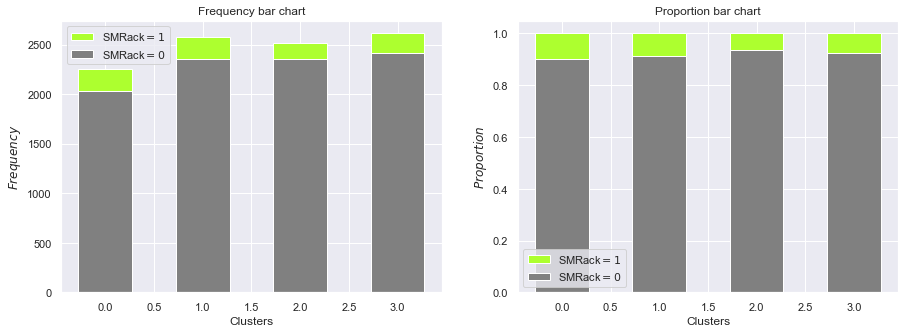

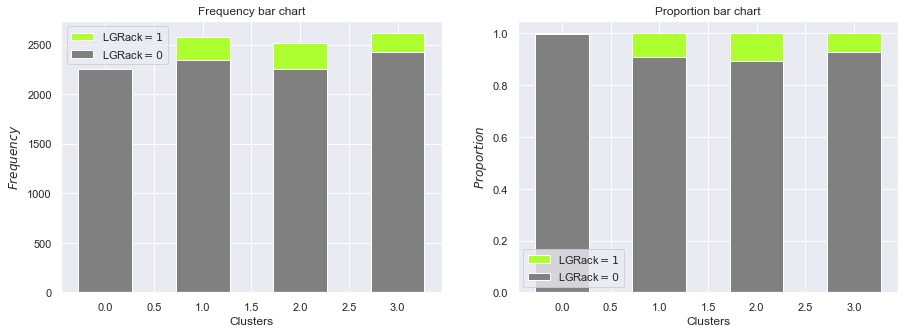

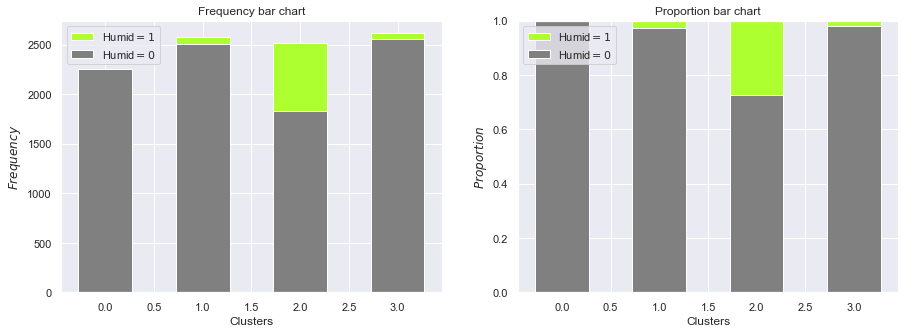

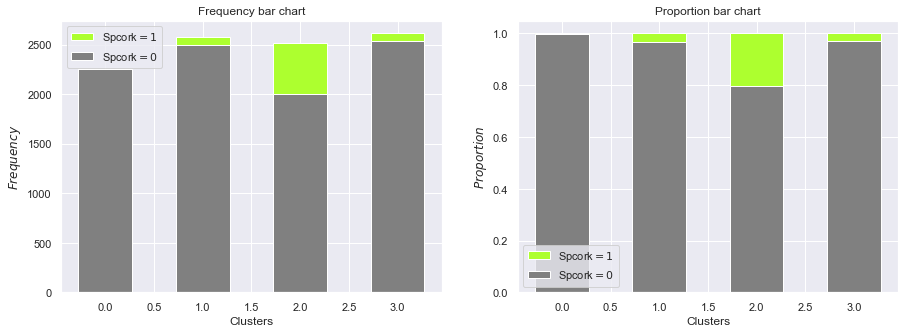

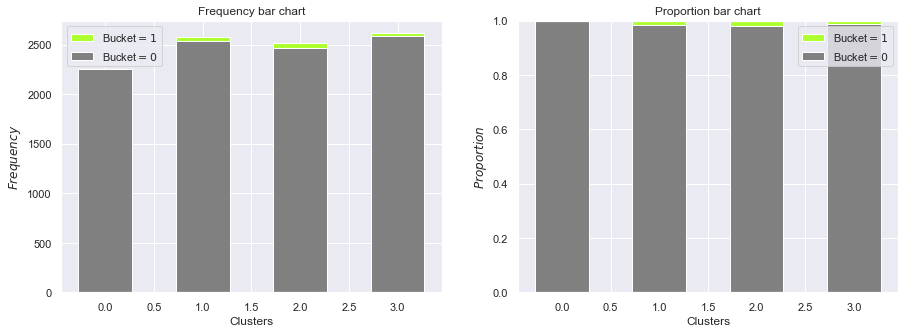

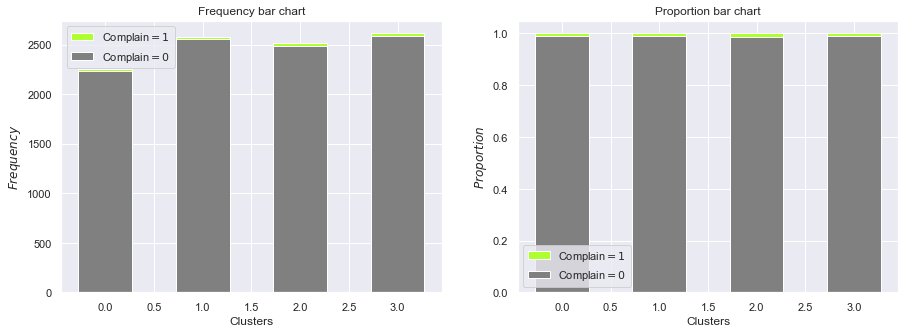

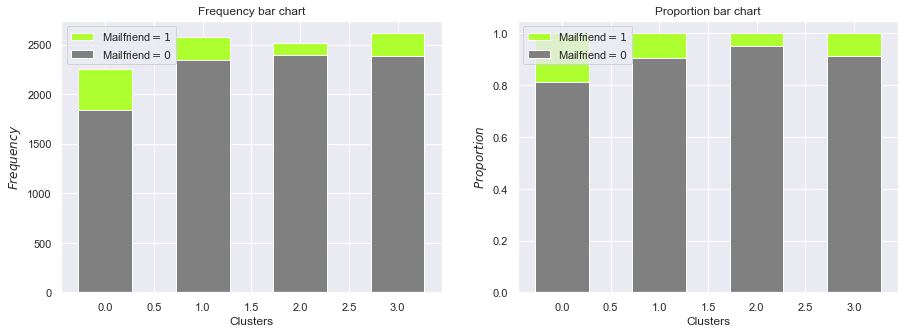

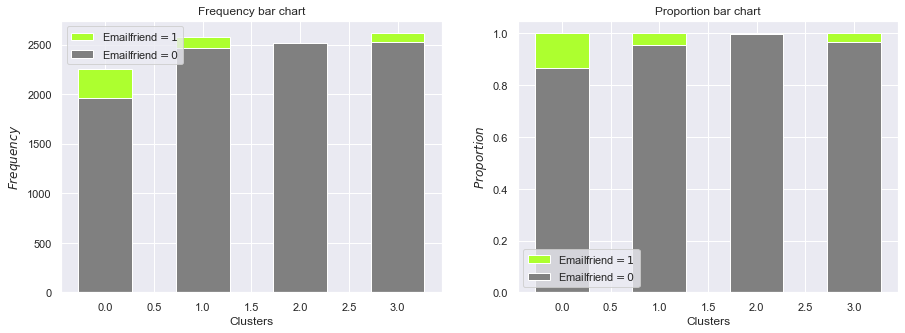

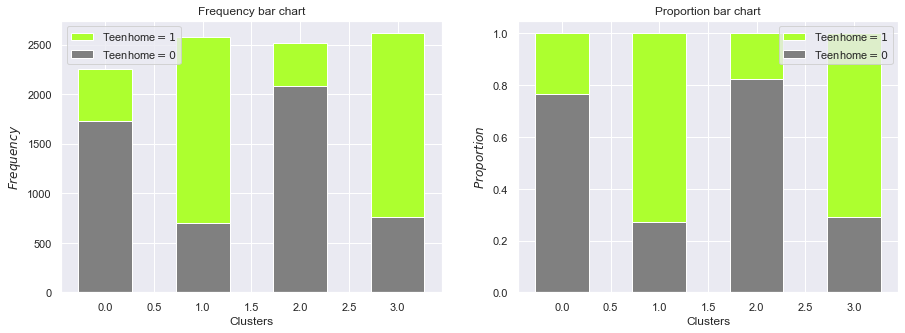

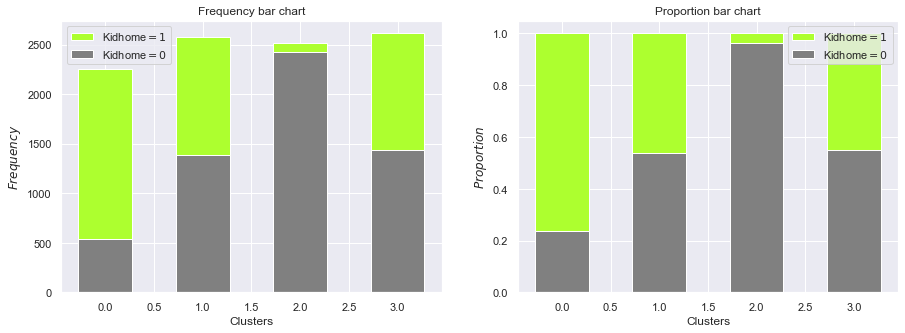

In [39]:
def bar_charts_categorical(df, feature, target):
    cont_tab = pd.crosstab(df[feature], df[target], margins = True)
    categories = cont_tab.index[:-1]

    fig = plt.figure(figsize=(15, 5))

    plt.subplot(121)
    p1 = plt.bar(categories, cont_tab.iloc[:-1, 0].values, 0.55, color="grey")
    p2 = plt.bar(categories, cont_tab.iloc[:-1, 1].values, 0.55, bottom=cont_tab.iloc[:-1, 0], color='Greenyellow')
    plt.legend((p2[0], p1[0]), (target+'$=1$', target+'$=0$'))
    plt.title("Frequency bar chart")
    plt.xlabel("Clusters")
    plt.ylabel("$Frequency$")
 
    # auxiliary data for 122
    obs_pct = np.array([np.divide(cont_tab.iloc[:-1, 0].values, cont_tab.iloc[:-1, 2].values), 
                        np.divide(cont_tab.iloc[:-1, 1].values, cont_tab.iloc[:-1, 2].values)])

    plt.subplot(122)
    p1 = plt.bar(categories, obs_pct[0], 0.55, color="grey")
    p2 = plt.bar(categories, obs_pct[1], 0.55, bottom=obs_pct[0], color='Greenyellow')
    plt.legend((p2[0], p1[0]), (target+'$=1$', target+'$=0$'))
    plt.title("Proportion bar chart")
    plt.xlabel("Clusters")
    plt.ylabel("$Proportion$")
 
    plt.show()
    
binary_profiling = ['SMRack','LGRack','Humid','Spcork','Bucket','Complain','Mailfriend','Emailfriend','Teenhome','Kidhome']
for var in binary_profiling:
    bar_charts_categorical(final_dataset, 'k_labels', var)

### 5.3 RFM analysis

In [40]:
RFM=['Freq','Recency','Monetary']
rfm_df= df[RFM]
quantiles = rfm_df.quantile(q=[0.25,0.5,0.75])
quantiles.to_dict()
def FMScore(x,p,d):
    if x <= d[p][0.25]:
        return '4'
    elif x <= d[p][0.50]:
        return '3'
    elif x <= d[p][0.75]: 
        return '2'
    else:
        return '1'
    
def RScore(x,p,d):
    if x <= d[p][0.25]:
        return '1'
    elif x <= d[p][0.50]:
        return '2'
    elif x <= d[p][0.75]: 
        return '3'
    else:
        return '4'
    
rfm_segmentation = rfm_df
rfm_segmentation['R_Quartile'] = rfm_segmentation['Recency'].apply(RScore, args=('Recency',quantiles,))
rfm_segmentation['F_Quartile'] = rfm_segmentation['Freq'].apply(FMScore, args=('Freq',quantiles,))
rfm_segmentation['M_Quartile'] = rfm_segmentation['Monetary'].apply(FMScore, args=('Monetary',quantiles,))

rfm_segmentation['RFMScore'] =rfm_segmentation['R_Quartile']+rfm_segmentation['F_Quartile']+rfm_segmentation['M_Quartile']

rfm_segmentation.reset_index(inplace=True)
rfm_segmentation = rfm_segmentation[['Custid','RFMScore','R_Quartile','F_Quartile','M_Quartile']]
final_dataset = final_dataset.merge(rfm_segmentation, on='Custid') 

print("Best Customers cluster 0: ",len(final_dataset.loc[(final_dataset['RFMScore']=='111') & (final_dataset['k_labels']==0)]))
print("Best Customers cluster 1: ",len(final_dataset.loc[(final_dataset['RFMScore']=='111') & (final_dataset['k_labels']==1)]))
print("Best Customers cluster 2: ",len(final_dataset.loc[(final_dataset['RFMScore']=='111') & (final_dataset['k_labels']==2)]))
print("Best Customers cluster 3: ",len(final_dataset.loc[(final_dataset['RFMScore']=='111') & (final_dataset['k_labels']==3)]))

print('')
print("Loyal Customers: 0: ",len(final_dataset.loc[(final_dataset['F_Quartile']=='1') & (final_dataset['k_labels']==0)]))
print("Loyal Customers: 1: ",len(final_dataset.loc[(final_dataset['F_Quartile']=='1') & (final_dataset['k_labels']==1)]))
print("Loyal Customers: 2: ",len(final_dataset.loc[(final_dataset['F_Quartile']=='1') & (final_dataset['k_labels']==2)]))
print("Loyal Customers: 3: ",len(final_dataset.loc[(final_dataset['F_Quartile']=='1') & (final_dataset['k_labels']==3)]))

print('')
print("Recent Customers: 0: ",len(final_dataset.loc[(final_dataset['R_Quartile']=='1') & (final_dataset['k_labels']==0)]))
print("Recent Customers: 1: ",len(final_dataset.loc[(final_dataset['R_Quartile']=='1') & (final_dataset['k_labels']==1)]))
print("Recent Customers: 2: ",len(final_dataset.loc[(final_dataset['R_Quartile']=='1') & (final_dataset['k_labels']==2)]))
print("Recent Customers: 3: ",len(final_dataset.loc[(final_dataset['R_Quartile']=='1') & (final_dataset['k_labels']==3)]))

print('')
print("Big Spenders 0: ",len(final_dataset.loc[(final_dataset['M_Quartile']=='1') & (final_dataset['k_labels']==0)]))
print("Big Spenders 1: ",len(final_dataset.loc[(final_dataset['M_Quartile']=='1') & (final_dataset['k_labels']==1)]))
print("Big Spenders 2: ",len(final_dataset.loc[(final_dataset['M_Quartile']=='1') & (final_dataset['k_labels']==2)]))
print("Big Spenders 3: ",len(final_dataset.loc[(final_dataset['M_Quartile']=='1') & (final_dataset['k_labels']==3)]))

print('')
print("Almost Lost 0: ",len(final_dataset.loc[(final_dataset['RFMScore']=='311') & (final_dataset['k_labels']==0)]))
print("Almost Lost 1: ",len(final_dataset.loc[(final_dataset['RFMScore']=='311') & (final_dataset['k_labels']==1)]))
print("Almost Lost 2: ",len(final_dataset.loc[(final_dataset['RFMScore']=='311') & (final_dataset['k_labels']==2)]))
print("Almost Lost 3: ",len(final_dataset.loc[(final_dataset['RFMScore']=='311') & (final_dataset['k_labels']==3)]))

print('')
print("Lost Customers 0: ",len(final_dataset.loc[(final_dataset['RFMScore']=='411') & (final_dataset['k_labels']==0)]))
print("Lost Customers 1: ",len(final_dataset.loc[(final_dataset['RFMScore']=='411') & (final_dataset['k_labels']==1)]))
print("Lost Customers 2: ",len(final_dataset.loc[(final_dataset['RFMScore']=='411') & (final_dataset['k_labels']==2)]))
print("Lost Customers 3: ",len(final_dataset.loc[(final_dataset['RFMScore']=='411') & (final_dataset['k_labels']==3)]))

print('')
print("Lost Cheap Customers 0: ",len(final_dataset.loc[(final_dataset['RFMScore']=='444') & (final_dataset['k_labels']==0)]))
print("Lost Cheap Customers 1: ",len(final_dataset.loc[(final_dataset['RFMScore']=='444') & (final_dataset['k_labels']==1)]))
print("Lost Cheap Customers 2: ",len(final_dataset.loc[(final_dataset['RFMScore']=='444') & (final_dataset['k_labels']==2)]))
print("Lost Cheap Customers 3: ",len(final_dataset.loc[(final_dataset['RFMScore']=='444') & (final_dataset['k_labels']==3)]))

Best Customers cluster 0:  0
Best Customers cluster 1:  94
Best Customers cluster 2:  484
Best Customers cluster 3:  23

Loyal Customers: 0:  3
Loyal Customers: 1:  403
Loyal Customers: 2:  1848
Loyal Customers: 3:  79

Recent Customers: 0:  544
Recent Customers: 1:  655
Recent Customers: 2:  665
Recent Customers: 3:  669

Big Spenders 0:  4
Big Spenders 1:  448
Big Spenders 2:  1926
Big Spenders 3:  95

Almost Lost 0:  1
Almost Lost 1:  117
Almost Lost 2:  513
Almost Lost 3:  18

Lost Customers 0:  1
Lost Customers 1:  81
Lost Customers 2:  415
Lost Customers 3:  16

Lost Cheap Customers 0:  479
Lost Cheap Customers 1:  116
Lost Cheap Customers 2:  1
Lost Cheap Customers 3:  260


# 6. Testing GMM clustering

In [66]:
#Step 1. Use BIC to understand what the most effective type of COV
#The best result should be the one that minimizes 

#check for ideal number of components
n_components = range(1, 20)

#look for ideal covariance type and number of components:

covariance_type = ['spherical', 'tied', 'diag', 'full']
score=[]
for cov in covariance_type:
    
    print('Covariance type:', cov)
    for n_comp in n_components:
        gmm=GaussianMixture(n_components=n_comp, max_iter = 1000, verbose_interval = 100, covariance_type=cov, random_state = 0, verbose = False)
        gmm.fit(final_df)
        score.append((cov,n_comp,gmm.bic(final_df)))
score

Covariance type: spherical
Covariance type: tied
Covariance type: diag
Covariance type: full


[('spherical', 1, -38506.09664119115),
 ('spherical', 2, -54260.403683699726),
 ('spherical', 3, -63754.65932410712),
 ('spherical', 4, -71283.59472441571),
 ('spherical', 5, -74490.58505739016),
 ('spherical', 6, -80600.10528293921),
 ('spherical', 7, -82953.39203590913),
 ('spherical', 8, -85288.91755666805),
 ('spherical', 9, -87541.30285697353),
 ('spherical', 10, -89282.90059320301),
 ('spherical', 11, -90328.94237076034),
 ('spherical', 12, -91685.47598154252),
 ('spherical', 13, -93005.166278061),
 ('spherical', 14, -93792.98569462242),
 ('spherical', 15, -94966.38774739667),
 ('spherical', 16, -95863.81519326664),
 ('spherical', 17, -96585.48023855608),
 ('spherical', 18, -97055.28330546508),
 ('spherical', 19, -97799.40536280922),
 ('tied', 1, -100910.68771334614),
 ('tied', 2, -104962.34946938866),
 ('tied', 3, -105082.0422545369),
 ('tied', 4, -110813.32973962104),
 ('tied', 5, -113199.81365393045),
 ('tied', 6, -114815.7312978761),
 ('tied', 7, -117245.77519270654),
 ('tied

In [67]:
#lowest values are on full Covariance type:
#Heuristic, find optimal initiation configuration by using kmeans initiation 10 times 
#GaussianMM selects the best scoring initiators

#Full Covariance gives the lowest values, so we plot AIC and BIC of the model with full covariance

#Find optimal initiator with for hypothetical 9 clusters 
GaussianMixture(n_components = 9, covariance_type='full', n_init = 10, max_iter = 1000, 
                verbose_interval = 100, random_state = 0, verbose = False).fit(final_df)

GaussianMixture(max_iter=1000, n_components=9, n_init=10, random_state=0,
                verbose=False, verbose_interval=100)

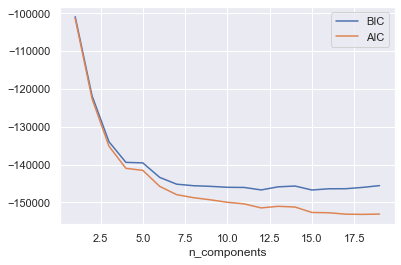

In [68]:
#find optimal number of componenets with previous initiation
#warm start allows to keep initiation from previous converging fit, which means that it will use the best scoring initiation,


#BIC AND AIC shoulg give an absolute minimum

n_components = np.arange(1, 20)
models = [GaussianMixture(n, covariance_type='full', warm_start = True, max_iter = 1000, 
        verbose_interval = 100, random_state = 0, verbose = False).fit(final_df) for n in n_components]
plt.plot(n_components, [m.bic(final_df) for m in models], label='BIC')
plt.plot(n_components, [m.aic(final_df) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components');

Initialization 0
Initialization converged: True	 time lapse 0.38995s	 ll 7.12093


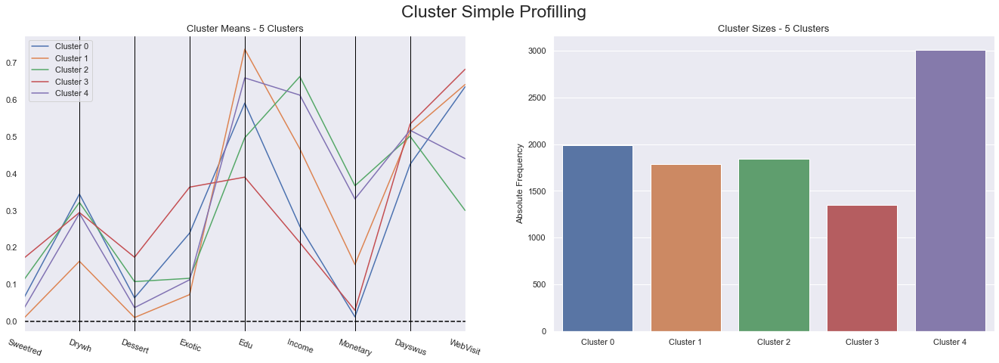

In [69]:
# Plotting at 5 clusters with previous initialization


fit = GaussianMixture(n_components=5, covariance_type='full', random_state=0, max_iter = 1000, 
                                     warm_start = True, verbose_interval = 100, verbose = 3).fit(final_df)
clust_labels = fit.predict(final_df)
gmm_df = final_df.copy()
gmm_df["gmm_labels"] = clust_labels
cluster_profiles(gmm_df, ["gmm_labels"], figsize=(23, 7))

In [70]:
#The higher the value the better

silhouette_score(final_df, clust_labels, random_state=0) 

0.02788947417627274

In [73]:
calinski_harabasz_score(final_df, clust_labels)

1084.5729027341765

In [74]:
r2(final_df, clust_labels)

0.30322242174895164